### Setup and Imports

In [18]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision
from torch.utils.data import DataLoader, Dataset
from torchvision.utils import save_image, make_grid
import torchvision.transforms as transforms
from PIL import Image
import itertools
import os
import glob
import random
import numpy as np
import matplotlib.pyplot as plt
import torchvision.utils as vutils
import os


In [19]:
# Reproducibility
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

set_seed(42)

# Device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")


Using device: cuda


### Dataset preparing

In [20]:
IMG_SIZE = 128
BATCH_SIZE = 4

transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))  
])

class Monet2PhotoDataset(Dataset):
    def __init__(self, root, transform=None, mode='train'):
        self.transform = transform
        self.monet_path = os.path.join(root, f'{mode}A')[:1900]  # Monet (style)
        self.photo_path = os.path.join(root, f'{mode}B')[:1900]  # Photo (content)
        self.monet_imgs = sorted(os.listdir(self.monet_path))
        self.photo_imgs = sorted(os.listdir(self.photo_path))

    def __len__(self):
        return min(len(self.monet_imgs), len(self.photo_imgs))

    def __getitem__(self, idx):
        monet = Image.open(os.path.join(self.monet_path, self.monet_imgs[idx])).convert("RGB")
        photo = Image.open(os.path.join(self.photo_path, self.photo_imgs[idx])).convert("RGB")

        if self.transform:
            monet = self.transform(monet)
            photo = self.transform(photo)

        return {"A": monet, "B": photo}

dataset_path = "./Painting_Dataset/"  # Change this path
train_dataset = Monet2PhotoDataset(dataset_path, transform=transform, mode='train')
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)


### Plot some original sample 

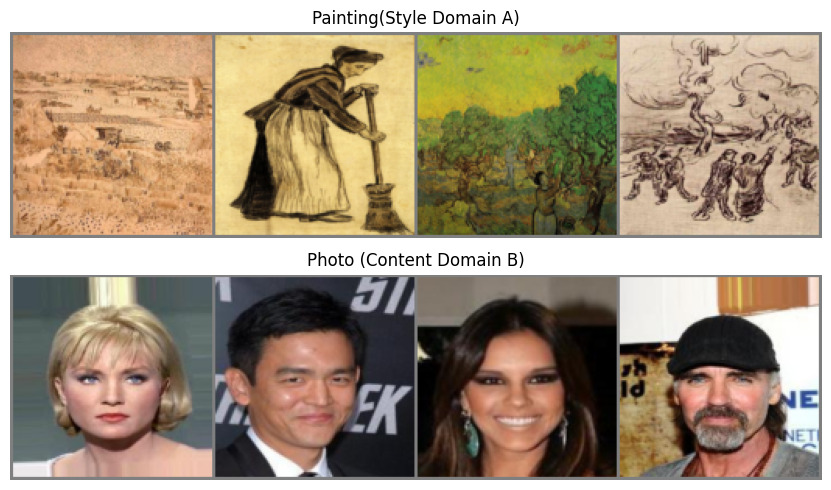

In [27]:
import matplotlib.pyplot as plt
import torchvision
import numpy as np

def imshow(img, title=None):
    img = img * 0.5 + 0.5  
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    if title:
        plt.title(title)
    plt.axis("off")

def show_sample_images(dataloader):
    batch = next(iter(dataloader)) 

    monet_images = batch["A"]  
    photo_images = batch["B"]

    monet_grid = torchvision.utils.make_grid(monet_images, nrow=4)
    photo_grid = torchvision.utils.make_grid(photo_images, nrow=4)

    plt.figure(figsize=(10, 5))

    plt.subplot(2, 1, 1)
    imshow(monet_grid, title="Painting(Style Domain A)")

    plt.subplot(2, 1, 2)
    imshow(photo_grid, title="Photo (Content Domain B)")

    plt.tight_layout()
    plt.show()
show_sample_images(train_loader)


### Model Architecture

In [28]:

# -------------------------------
# U-Net Generator for CycleGAN
# -------------------------------
class UNetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, down=True, use_dropout=False):
        super().__init__()
        if down:
            self.block = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, 4, 2, 1, bias=False),
                nn.InstanceNorm2d(out_channels),
                nn.LeakyReLU(0.2, inplace=True)
            )
        else:
            self.block = nn.Sequential(
                nn.ConvTranspose2d(in_channels, out_channels, 4, 2, 1, bias=False),
                nn.InstanceNorm2d(out_channels),
                nn.ReLU(inplace=True)
            )
        self.use_dropout = use_dropout
        if use_dropout:
            self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        x = self.block(x)
        return self.dropout(x) if self.use_dropout else x


class Generator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3):
        super().__init__()

        # Encoder (downsampling)
        self.down1 = nn.Conv2d(in_channels, 64, 4, 2, 1)  
        self.down2 = UNetBlock(64, 128, down=True)
        self.down3 = UNetBlock(128, 256, down=True)
        self.down4 = UNetBlock(256, 512, down=True)
        self.down5 = UNetBlock(512, 512, down=True)

        # Decoder (upsampling)
        self.up1 = UNetBlock(512, 512, down=False, use_dropout=True)
        self.up2 = UNetBlock(1024, 256, down=False)
        self.up3 = UNetBlock(512, 128, down=False)
        self.up4 = UNetBlock(256, 64, down=False)

        self.final = nn.Sequential(
            nn.ConvTranspose2d(128, out_channels, 4, 2, 1),
            nn.Tanh()
        )

    def forward(self, x):
        # Encoding path
        d1 = F.leaky_relu(self.down1(x), 0.2)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)

        # Decoding path with skip connections
        u1 = self.up1(d5)
        u2 = self.up2(torch.cat([u1, d4], dim=1))
        u3 = self.up3(torch.cat([u2, d3], dim=1))
        u4 = self.up4(torch.cat([u3, d2], dim=1))
        out = self.final(torch.cat([u4, d1], dim=1))
        return out


# -------------------------------
# Discriminator for CycleGAN
# -------------------------------
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        def conv(in_channels, out_channels, stride):
            return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, 4, stride, 1),
                nn.InstanceNorm2d(out_channels),
                nn.LeakyReLU(0.2, inplace=True)
            )

        self.model = nn.Sequential(
            nn.Conv2d(3, 64, 4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            conv(64, 128, 2),
            conv(128, 256, 2),
            conv(256, 512, 1),
            nn.Conv2d(512, 1, 4, padding=1)  # PatchGAN
        )

    def forward(self, x):
        return self.model(x)


### Model initialization, Loss function, Optimizer configuration

In [29]:
# Model initialization 
G_AB = Generator().to(device)  # Translates A (Monet) → B (Photo)
G_BA = Generator().to(device)  # Translates B (Photo) → A (Monet)
D_A = Discriminator().to(device)   # Discriminates in domain A (Monet)
D_B = Discriminator().to(device)   # Discriminates in domain B (Photo)

# Loss functions
adv_criterion = nn.MSELoss()       # Adversarial loss
cycle_criterion = nn.L1Loss()      # Cycle consistency loss
identity_criterion = nn.L1Loss()   # Identity loss 

# Optimizers
lr = 0.0002
beta1 = 0.5

opt_G = optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()),
    lr=lr, betas=(beta1, 0.999)
)
opt_D_A = optim.Adam(D_A.parameters(), lr=lr, betas=(beta1, 0.999))
opt_D_B = optim.Adam(D_B.parameters(), lr=lr, betas=(beta1, 0.999))

### Training Loop

Epoch [1/20] | Step [0] | Loss_G: 21.5153 | Loss_D_A: 1.1269 | Loss_D_B: 1.2029
Epoch [1/20] | Step [100] | Loss_G: 4.7451 | Loss_D_A: 0.3478 | Loss_D_B: 0.3708
Epoch [1/20] | Step [200] | Loss_G: 4.4797 | Loss_D_A: 0.2189 | Loss_D_B: 0.3557
Epoch [1/20] | Step [300] | Loss_G: 3.8062 | Loss_D_A: 0.2985 | Loss_D_B: 0.4063
Epoch [1/20] | Step [400] | Loss_G: 3.7846 | Loss_D_A: 0.3840 | Loss_D_B: 0.2231


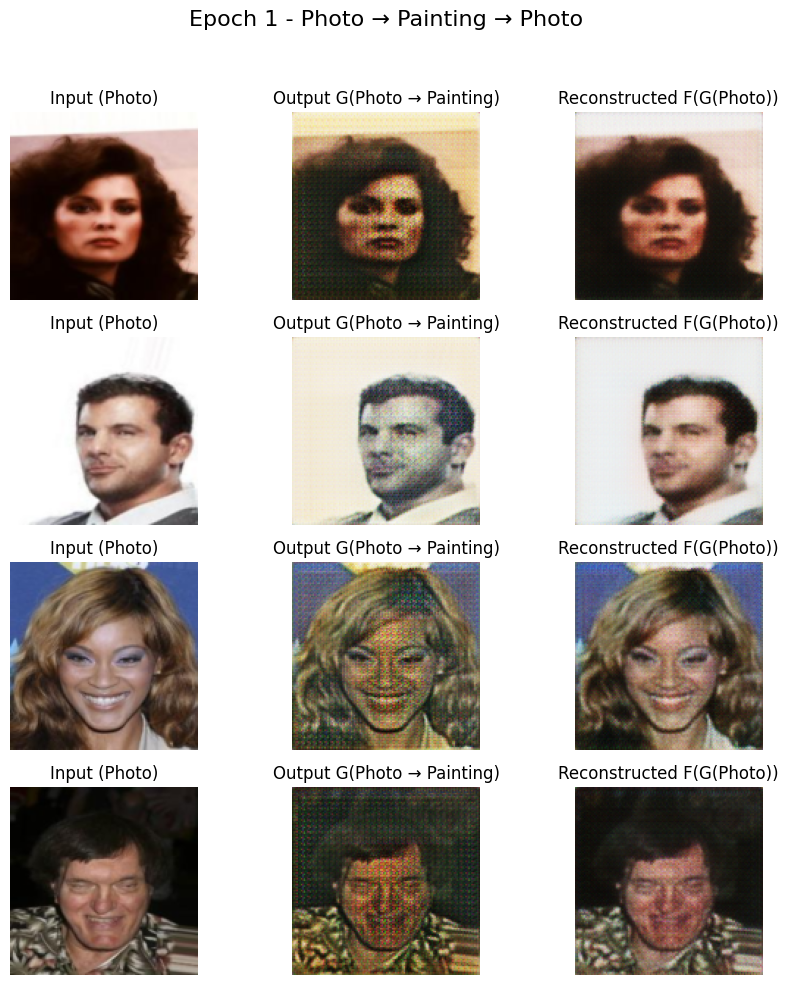

Epoch [2/20] | Step [0] | Loss_G: 3.6829 | Loss_D_A: 0.4679 | Loss_D_B: 0.4529
Epoch [2/20] | Step [100] | Loss_G: 3.2940 | Loss_D_A: 0.2875 | Loss_D_B: 0.5860
Epoch [2/20] | Step [200] | Loss_G: 3.9442 | Loss_D_A: 0.2299 | Loss_D_B: 0.2515
Epoch [2/20] | Step [300] | Loss_G: 3.7711 | Loss_D_A: 0.3432 | Loss_D_B: 0.2249
Epoch [2/20] | Step [400] | Loss_G: 3.7919 | Loss_D_A: 0.3529 | Loss_D_B: 0.2515


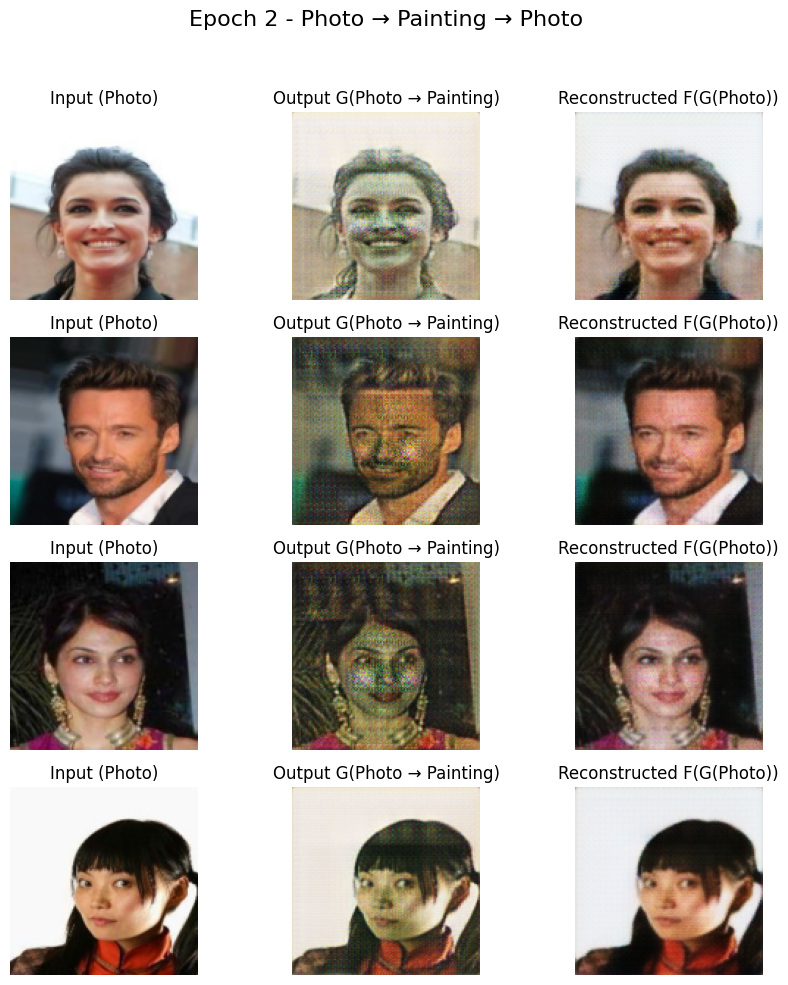

Epoch [3/20] | Step [0] | Loss_G: 3.0636 | Loss_D_A: 0.2927 | Loss_D_B: 0.1981
Epoch [3/20] | Step [100] | Loss_G: 3.7691 | Loss_D_A: 0.1837 | Loss_D_B: 0.1788
Epoch [3/20] | Step [200] | Loss_G: 3.4660 | Loss_D_A: 0.2782 | Loss_D_B: 0.0973
Epoch [3/20] | Step [300] | Loss_G: 3.0376 | Loss_D_A: 0.3557 | Loss_D_B: 0.2076
Epoch [3/20] | Step [400] | Loss_G: 3.9023 | Loss_D_A: 0.4005 | Loss_D_B: 0.0556


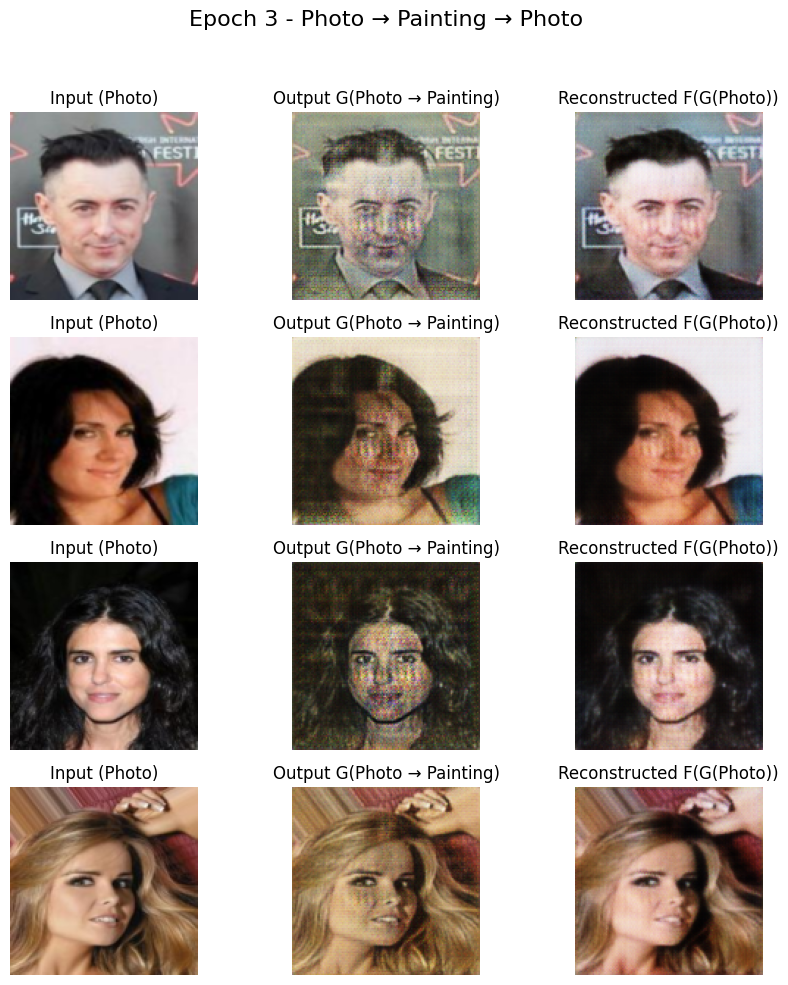

Epoch [4/20] | Step [0] | Loss_G: 2.6759 | Loss_D_A: 0.3623 | Loss_D_B: 0.2951
Epoch [4/20] | Step [100] | Loss_G: 3.2295 | Loss_D_A: 0.3512 | Loss_D_B: 0.1600
Epoch [4/20] | Step [200] | Loss_G: 3.1044 | Loss_D_A: 0.2747 | Loss_D_B: 0.1853
Epoch [4/20] | Step [300] | Loss_G: 3.8315 | Loss_D_A: 0.3549 | Loss_D_B: 0.1686
Epoch [4/20] | Step [400] | Loss_G: 3.8439 | Loss_D_A: 0.2233 | Loss_D_B: 0.4428


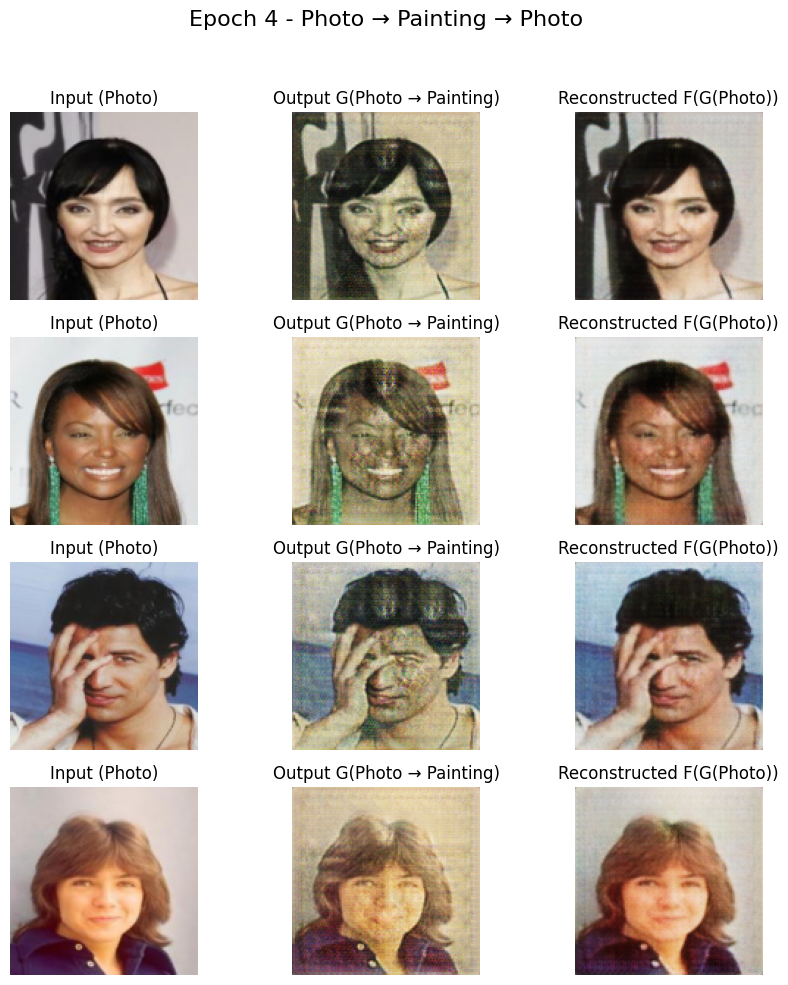

Epoch [5/20] | Step [0] | Loss_G: 3.2716 | Loss_D_A: 0.3099 | Loss_D_B: 0.2560
Epoch [5/20] | Step [100] | Loss_G: 3.3865 | Loss_D_A: 0.0943 | Loss_D_B: 0.1908
Epoch [5/20] | Step [200] | Loss_G: 3.5891 | Loss_D_A: 0.1239 | Loss_D_B: 0.1065
Epoch [5/20] | Step [300] | Loss_G: 3.8733 | Loss_D_A: 0.1586 | Loss_D_B: 0.1126
Epoch [5/20] | Step [400] | Loss_G: 3.9310 | Loss_D_A: 0.1527 | Loss_D_B: 0.1631


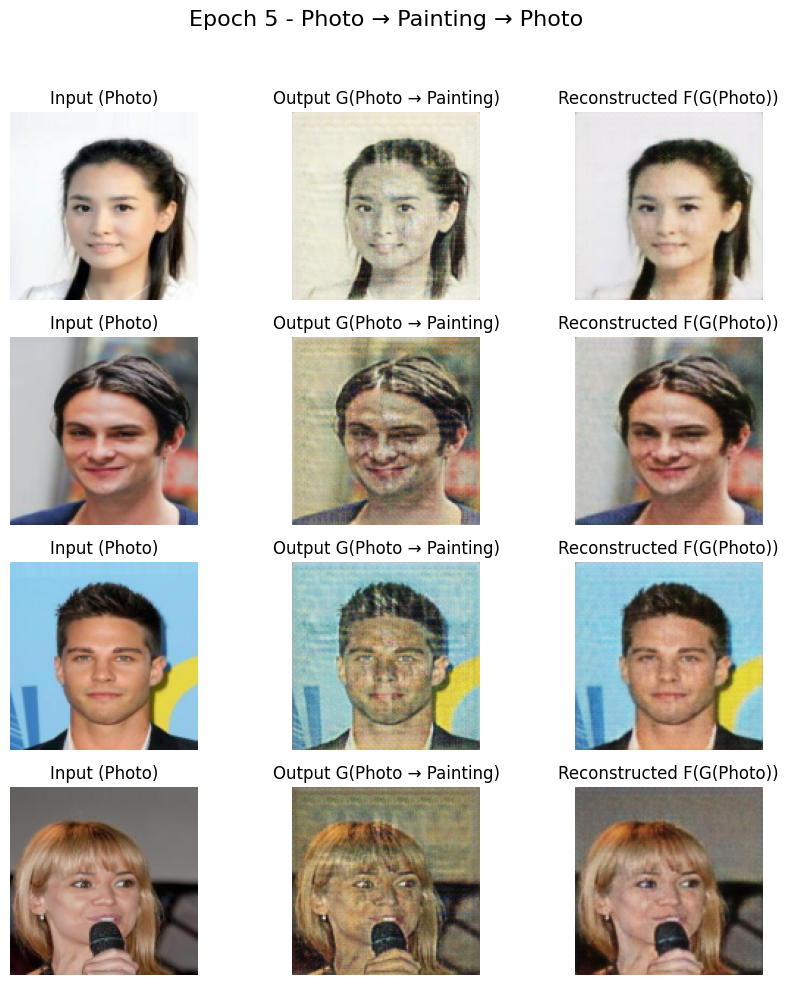

Epoch [6/20] | Step [0] | Loss_G: 4.1233 | Loss_D_A: 0.1173 | Loss_D_B: 0.0702
Epoch [6/20] | Step [100] | Loss_G: 3.7208 | Loss_D_A: 0.2015 | Loss_D_B: 0.4670
Epoch [6/20] | Step [200] | Loss_G: 3.3436 | Loss_D_A: 0.0680 | Loss_D_B: 0.0344
Epoch [6/20] | Step [300] | Loss_G: 4.1490 | Loss_D_A: 0.0978 | Loss_D_B: 0.2451
Epoch [6/20] | Step [400] | Loss_G: 3.6663 | Loss_D_A: 0.4058 | Loss_D_B: 0.1142


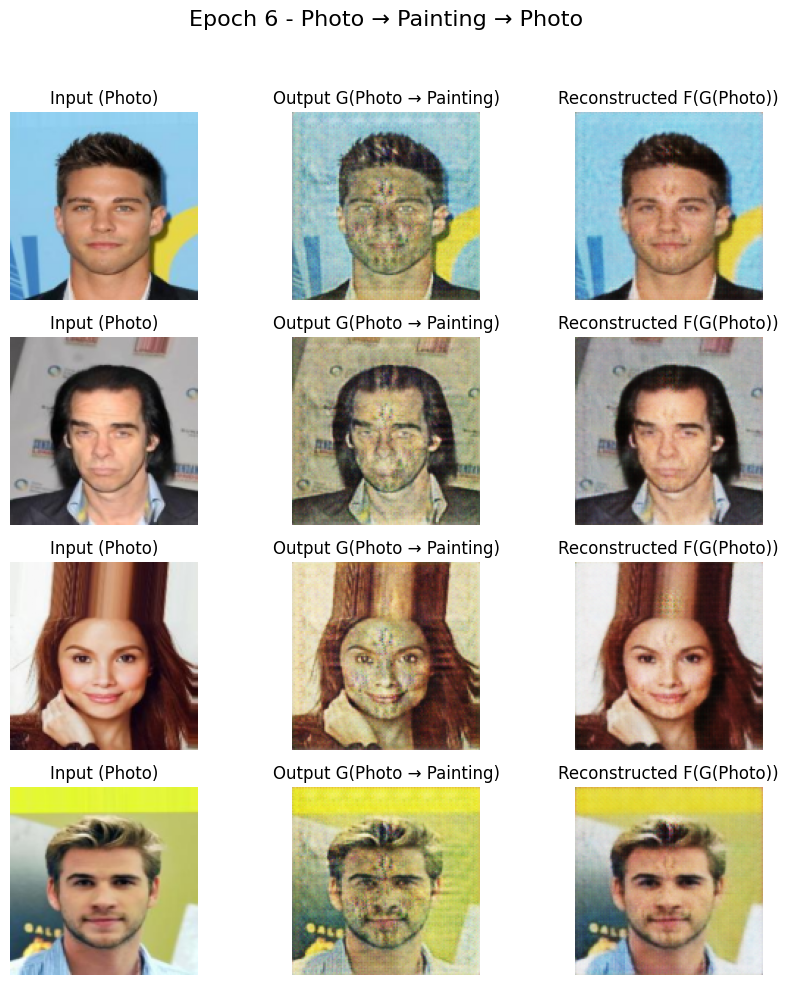

Epoch [7/20] | Step [0] | Loss_G: 2.9679 | Loss_D_A: 0.3083 | Loss_D_B: 0.1293
Epoch [7/20] | Step [100] | Loss_G: 3.3585 | Loss_D_A: 0.1212 | Loss_D_B: 0.2473
Epoch [7/20] | Step [200] | Loss_G: 2.9879 | Loss_D_A: 0.1232 | Loss_D_B: 0.1312
Epoch [7/20] | Step [300] | Loss_G: 3.6220 | Loss_D_A: 0.1463 | Loss_D_B: 0.1216
Epoch [7/20] | Step [400] | Loss_G: 3.3761 | Loss_D_A: 0.1409 | Loss_D_B: 0.0481


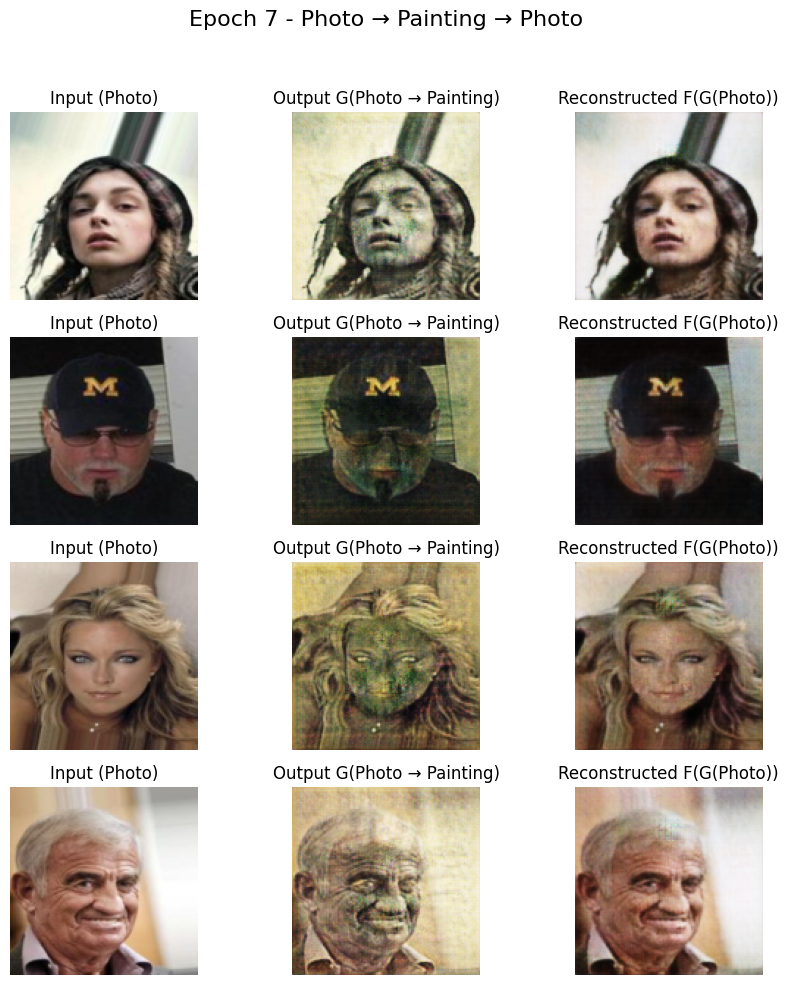

Epoch [8/20] | Step [0] | Loss_G: 3.4002 | Loss_D_A: 0.1298 | Loss_D_B: 0.0756
Epoch [8/20] | Step [100] | Loss_G: 3.8285 | Loss_D_A: 0.0549 | Loss_D_B: 0.1091
Epoch [8/20] | Step [200] | Loss_G: 2.4514 | Loss_D_A: 0.2385 | Loss_D_B: 0.2426
Epoch [8/20] | Step [300] | Loss_G: 4.1059 | Loss_D_A: 0.1263 | Loss_D_B: 0.0401
Epoch [8/20] | Step [400] | Loss_G: 4.3945 | Loss_D_A: 0.3910 | Loss_D_B: 0.1677


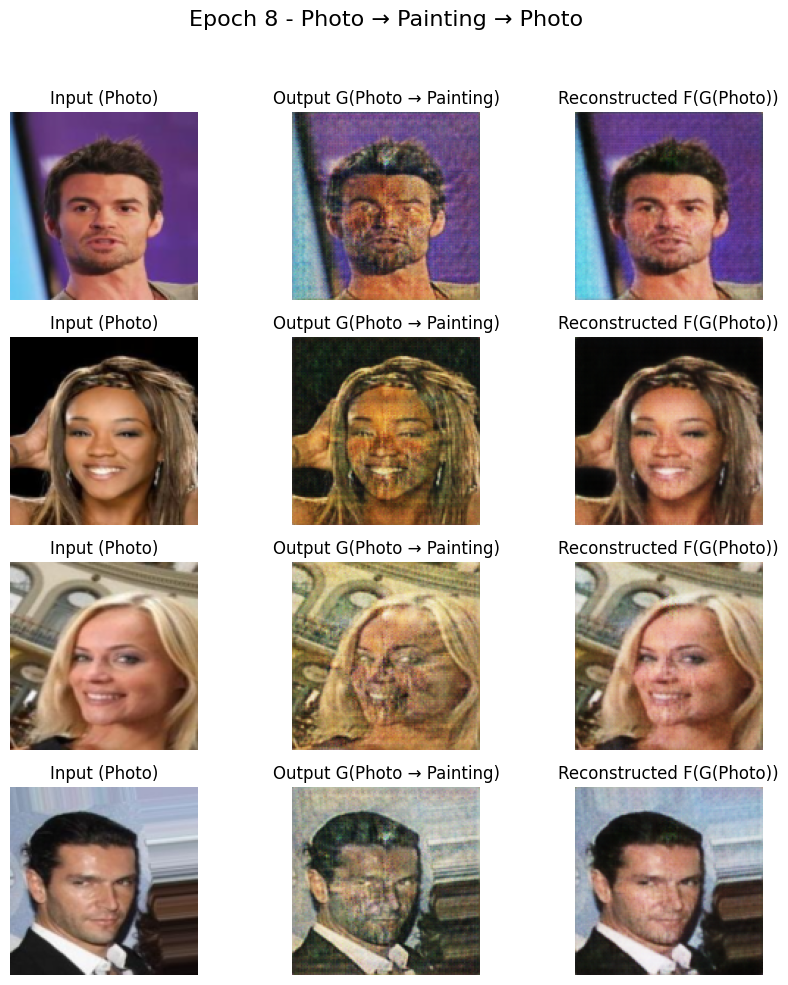

Epoch [9/20] | Step [0] | Loss_G: 3.7615 | Loss_D_A: 0.1010 | Loss_D_B: 0.0588
Epoch [9/20] | Step [100] | Loss_G: 3.6625 | Loss_D_A: 0.2247 | Loss_D_B: 0.0364
Epoch [9/20] | Step [200] | Loss_G: 3.2771 | Loss_D_A: 0.1329 | Loss_D_B: 0.0696
Epoch [9/20] | Step [300] | Loss_G: 3.7700 | Loss_D_A: 0.0584 | Loss_D_B: 0.0343
Epoch [9/20] | Step [400] | Loss_G: 3.6557 | Loss_D_A: 0.0628 | Loss_D_B: 0.5409


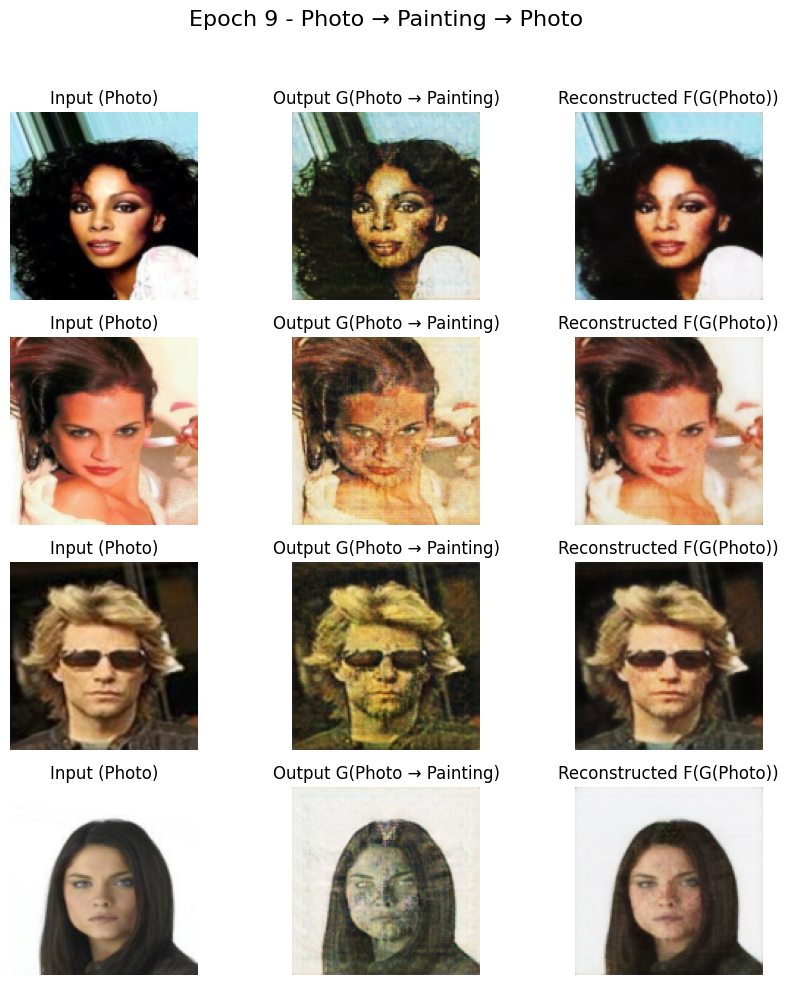

Epoch [10/20] | Step [0] | Loss_G: 3.3904 | Loss_D_A: 0.0982 | Loss_D_B: 0.1546
Epoch [10/20] | Step [100] | Loss_G: 3.5493 | Loss_D_A: 0.1046 | Loss_D_B: 0.0963
Epoch [10/20] | Step [200] | Loss_G: 3.1521 | Loss_D_A: 0.1762 | Loss_D_B: 0.0352
Epoch [10/20] | Step [300] | Loss_G: 2.6647 | Loss_D_A: 0.2203 | Loss_D_B: 0.0674
Epoch [10/20] | Step [400] | Loss_G: 3.9141 | Loss_D_A: 0.1925 | Loss_D_B: 0.1031


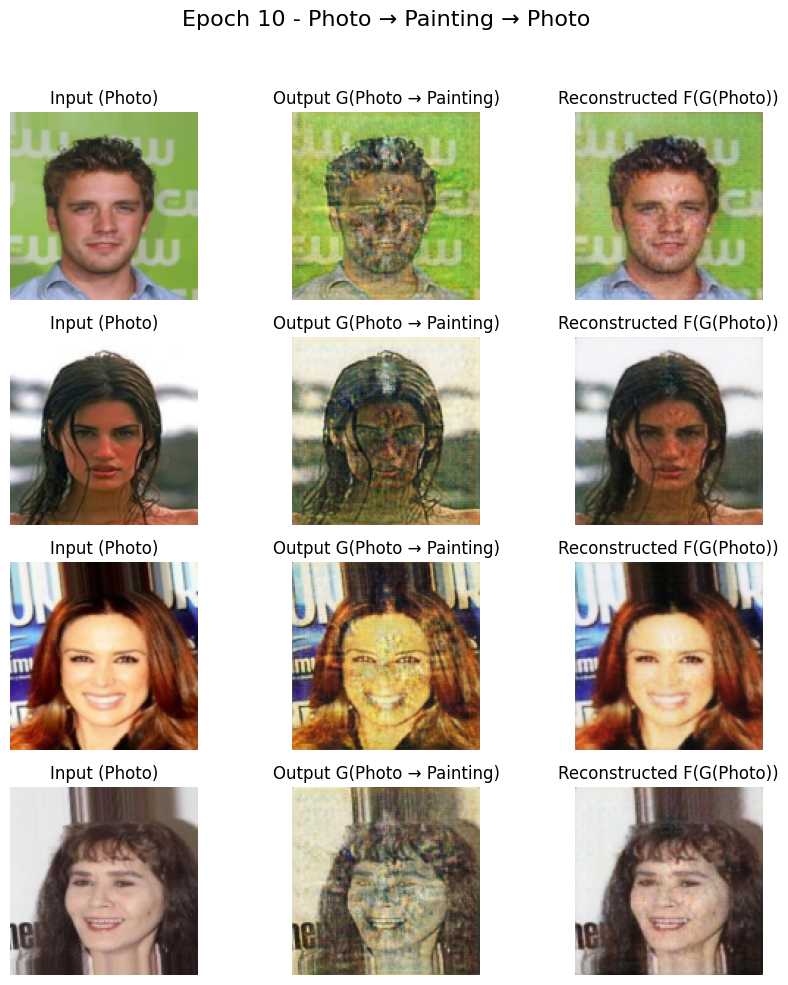

Epoch [11/20] | Step [0] | Loss_G: 3.6003 | Loss_D_A: 0.2527 | Loss_D_B: 0.2835
Epoch [11/20] | Step [100] | Loss_G: 3.5460 | Loss_D_A: 0.0758 | Loss_D_B: 0.0262
Epoch [11/20] | Step [200] | Loss_G: 3.4664 | Loss_D_A: 0.1208 | Loss_D_B: 0.0468
Epoch [11/20] | Step [300] | Loss_G: 3.3250 | Loss_D_A: 0.0574 | Loss_D_B: 0.0223
Epoch [11/20] | Step [400] | Loss_G: 3.4116 | Loss_D_A: 0.0540 | Loss_D_B: 0.0535


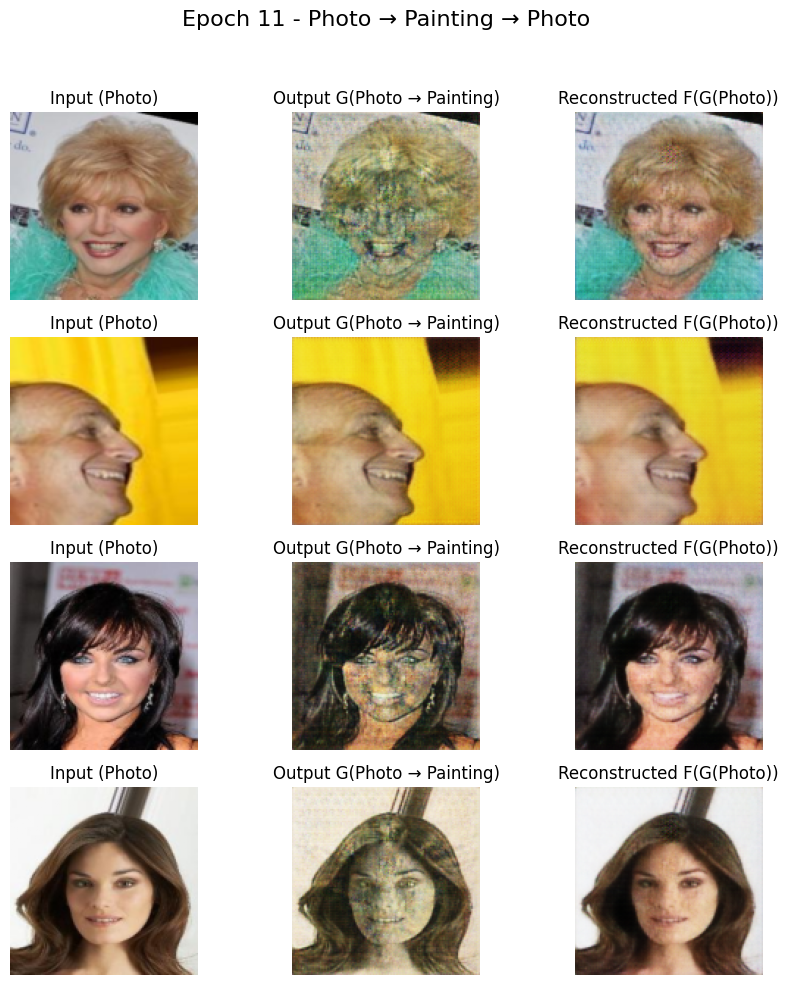

Epoch [12/20] | Step [0] | Loss_G: 3.8600 | Loss_D_A: 0.0413 | Loss_D_B: 0.0097
Epoch [12/20] | Step [100] | Loss_G: 3.8776 | Loss_D_A: 0.1018 | Loss_D_B: 0.0740
Epoch [12/20] | Step [200] | Loss_G: 2.5946 | Loss_D_A: 0.3037 | Loss_D_B: 0.1802
Epoch [12/20] | Step [300] | Loss_G: 3.5719 | Loss_D_A: 0.1956 | Loss_D_B: 0.0175
Epoch [12/20] | Step [400] | Loss_G: 2.9269 | Loss_D_A: 0.0947 | Loss_D_B: 0.0777


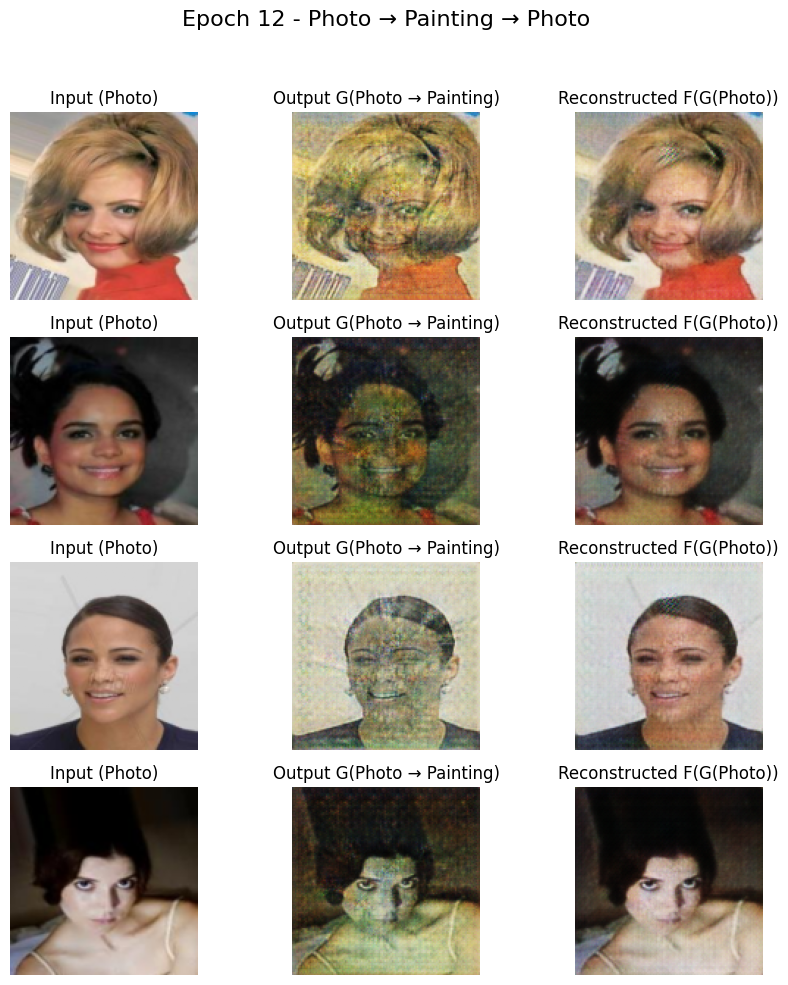

Epoch [13/20] | Step [0] | Loss_G: 3.4457 | Loss_D_A: 0.0312 | Loss_D_B: 0.0117
Epoch [13/20] | Step [100] | Loss_G: 3.5003 | Loss_D_A: 0.0299 | Loss_D_B: 0.0320
Epoch [13/20] | Step [200] | Loss_G: 3.0179 | Loss_D_A: 0.1623 | Loss_D_B: 0.0674
Epoch [13/20] | Step [300] | Loss_G: 3.2536 | Loss_D_A: 0.1456 | Loss_D_B: 0.0167
Epoch [13/20] | Step [400] | Loss_G: 2.9928 | Loss_D_A: 0.2279 | Loss_D_B: 0.1276


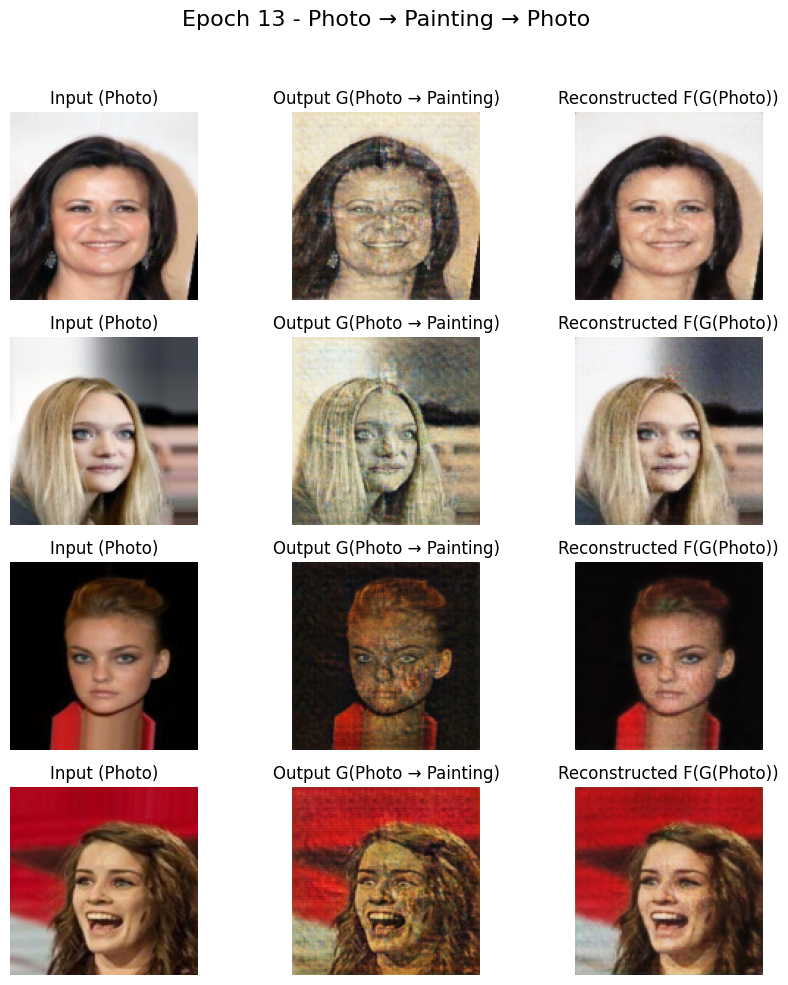

Epoch [14/20] | Step [0] | Loss_G: 3.5069 | Loss_D_A: 0.1288 | Loss_D_B: 0.0258
Epoch [14/20] | Step [100] | Loss_G: 2.9661 | Loss_D_A: 0.1117 | Loss_D_B: 0.0289
Epoch [14/20] | Step [200] | Loss_G: 3.2911 | Loss_D_A: 0.0477 | Loss_D_B: 0.2601
Epoch [14/20] | Step [300] | Loss_G: 3.7155 | Loss_D_A: 0.2989 | Loss_D_B: 0.0237
Epoch [14/20] | Step [400] | Loss_G: 3.2738 | Loss_D_A: 0.0590 | Loss_D_B: 0.0597


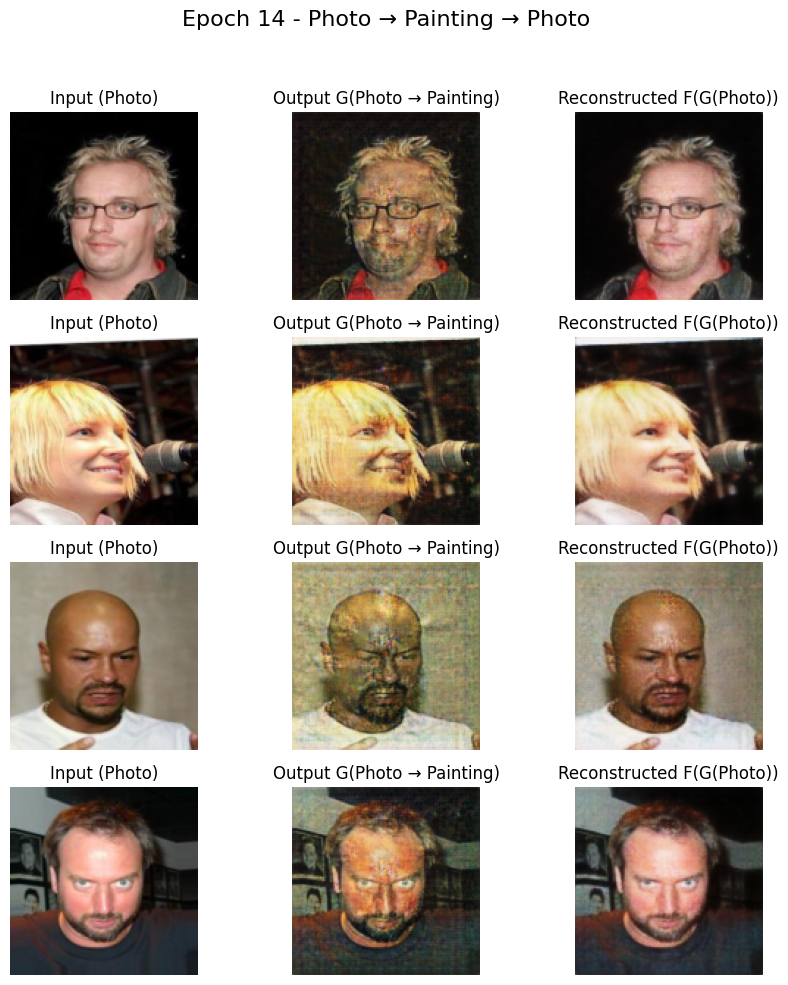

Epoch [15/20] | Step [0] | Loss_G: 3.1000 | Loss_D_A: 0.0484 | Loss_D_B: 0.0064
Epoch [15/20] | Step [100] | Loss_G: 2.9487 | Loss_D_A: 0.0743 | Loss_D_B: 0.0204
Epoch [15/20] | Step [200] | Loss_G: 3.0461 | Loss_D_A: 0.1509 | Loss_D_B: 0.0050
Epoch [15/20] | Step [300] | Loss_G: 2.9444 | Loss_D_A: 0.0946 | Loss_D_B: 0.0118
Epoch [15/20] | Step [400] | Loss_G: 3.3900 | Loss_D_A: 0.0639 | Loss_D_B: 0.0839


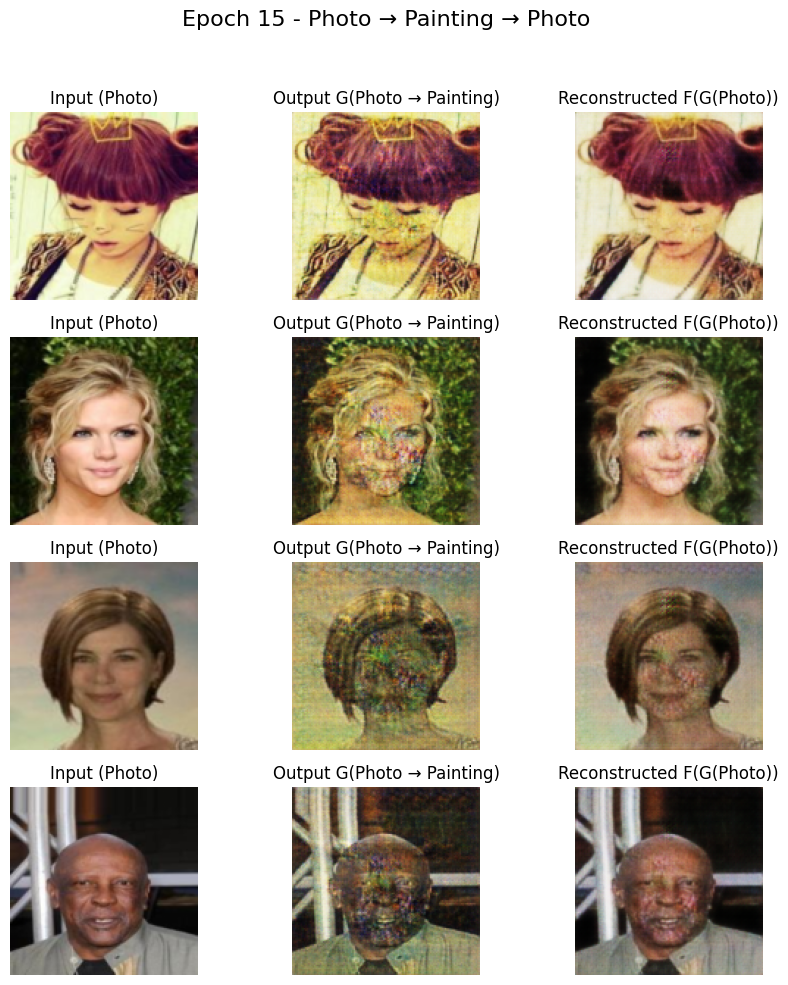

Epoch [16/20] | Step [0] | Loss_G: 3.6736 | Loss_D_A: 0.0592 | Loss_D_B: 0.3105
Epoch [16/20] | Step [100] | Loss_G: 2.8725 | Loss_D_A: 0.1815 | Loss_D_B: 0.0193
Epoch [16/20] | Step [200] | Loss_G: 3.1647 | Loss_D_A: 0.0768 | Loss_D_B: 0.0065
Epoch [16/20] | Step [300] | Loss_G: 2.9848 | Loss_D_A: 0.2450 | Loss_D_B: 0.1218
Epoch [16/20] | Step [400] | Loss_G: 2.9730 | Loss_D_A: 0.2318 | Loss_D_B: 0.0381


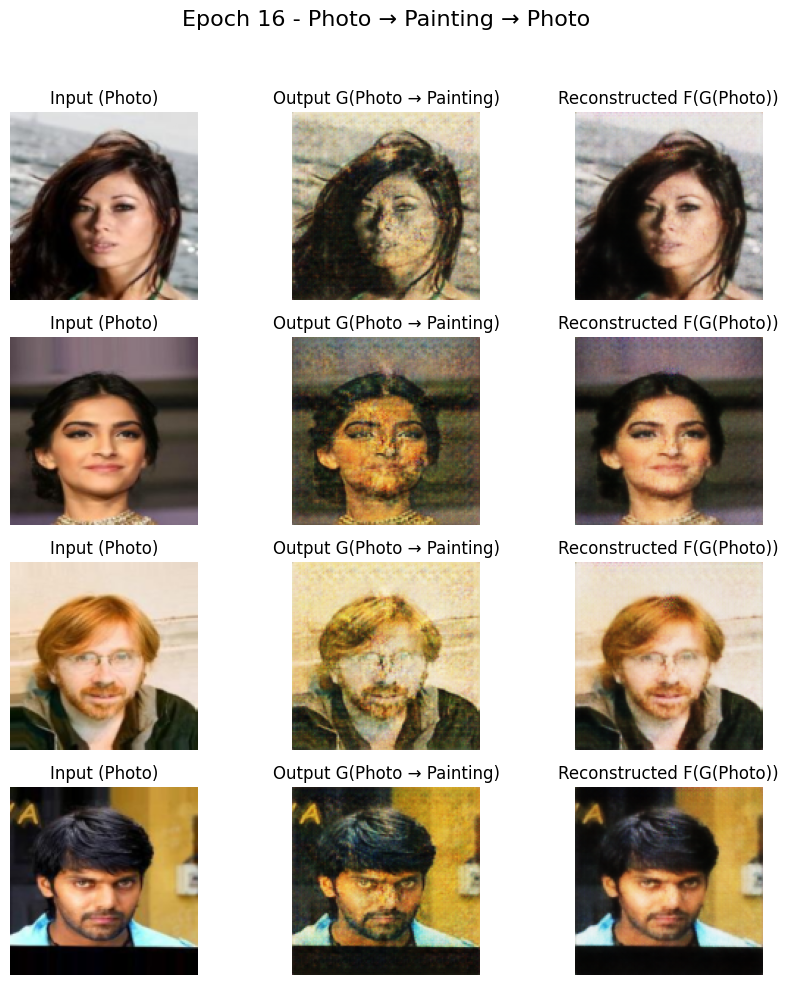

Epoch [17/20] | Step [0] | Loss_G: 3.7128 | Loss_D_A: 0.2169 | Loss_D_B: 0.0874
Epoch [17/20] | Step [100] | Loss_G: 3.1059 | Loss_D_A: 0.0982 | Loss_D_B: 0.0100
Epoch [17/20] | Step [200] | Loss_G: 3.1411 | Loss_D_A: 0.0349 | Loss_D_B: 0.0079
Epoch [17/20] | Step [300] | Loss_G: 3.1554 | Loss_D_A: 0.0567 | Loss_D_B: 0.0273
Epoch [17/20] | Step [400] | Loss_G: 2.8444 | Loss_D_A: 0.2597 | Loss_D_B: 0.1120


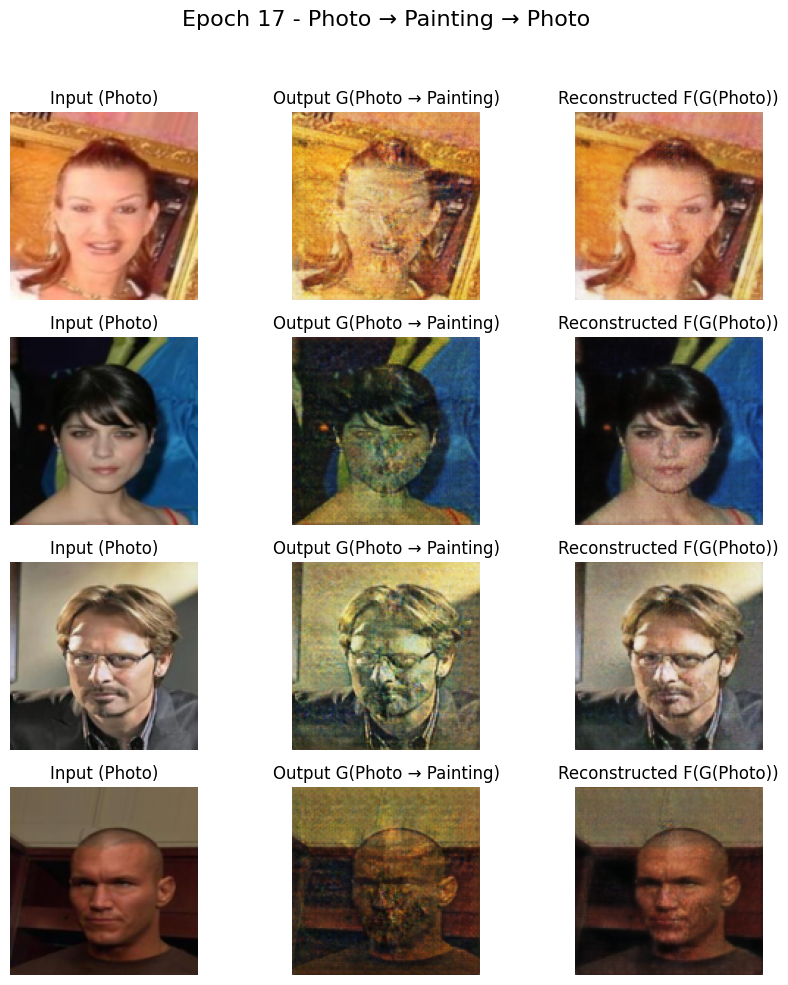

Epoch [18/20] | Step [0] | Loss_G: 3.8500 | Loss_D_A: 0.0434 | Loss_D_B: 0.0734
Epoch [18/20] | Step [100] | Loss_G: 3.2316 | Loss_D_A: 0.1192 | Loss_D_B: 0.0282
Epoch [18/20] | Step [200] | Loss_G: 2.8698 | Loss_D_A: 0.0953 | Loss_D_B: 0.0068
Epoch [18/20] | Step [300] | Loss_G: 2.8843 | Loss_D_A: 0.2600 | Loss_D_B: 0.0044
Epoch [18/20] | Step [400] | Loss_G: 3.2231 | Loss_D_A: 0.0629 | Loss_D_B: 0.0174


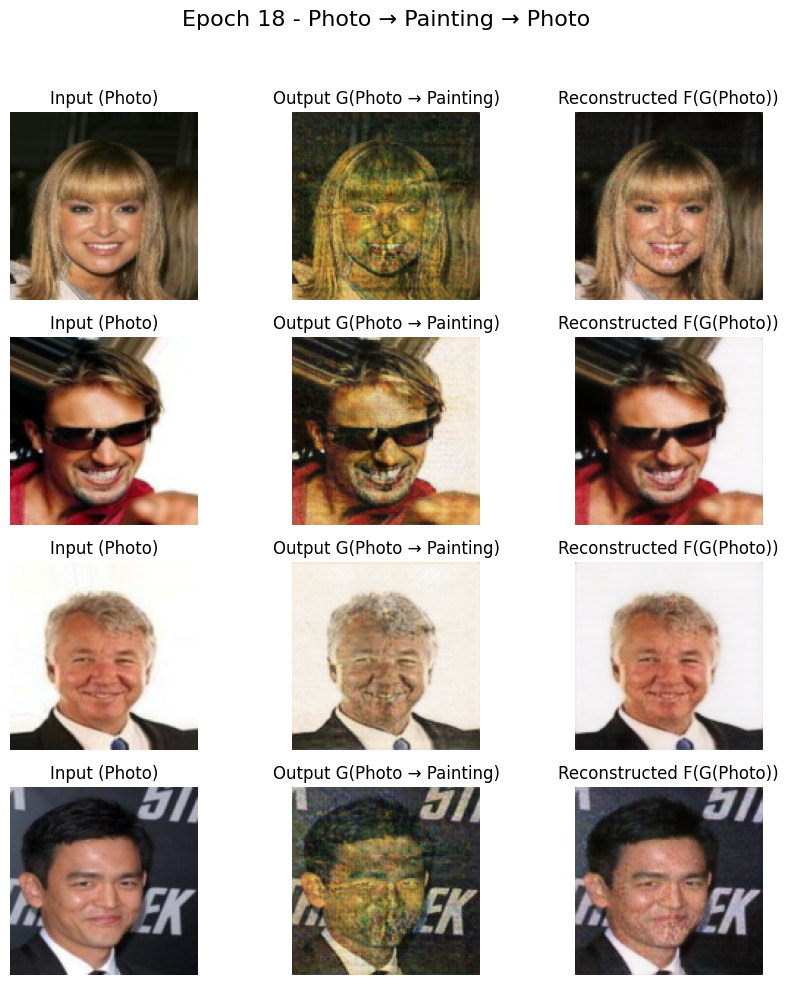

Epoch [19/20] | Step [0] | Loss_G: 3.3886 | Loss_D_A: 0.1514 | Loss_D_B: 0.0210
Epoch [19/20] | Step [100] | Loss_G: 3.0277 | Loss_D_A: 0.0570 | Loss_D_B: 0.0047
Epoch [19/20] | Step [200] | Loss_G: 2.4876 | Loss_D_A: 0.1598 | Loss_D_B: 0.2430
Epoch [19/20] | Step [300] | Loss_G: 3.2444 | Loss_D_A: 0.0495 | Loss_D_B: 0.0063
Epoch [19/20] | Step [400] | Loss_G: 3.7819 | Loss_D_A: 0.2199 | Loss_D_B: 0.0123


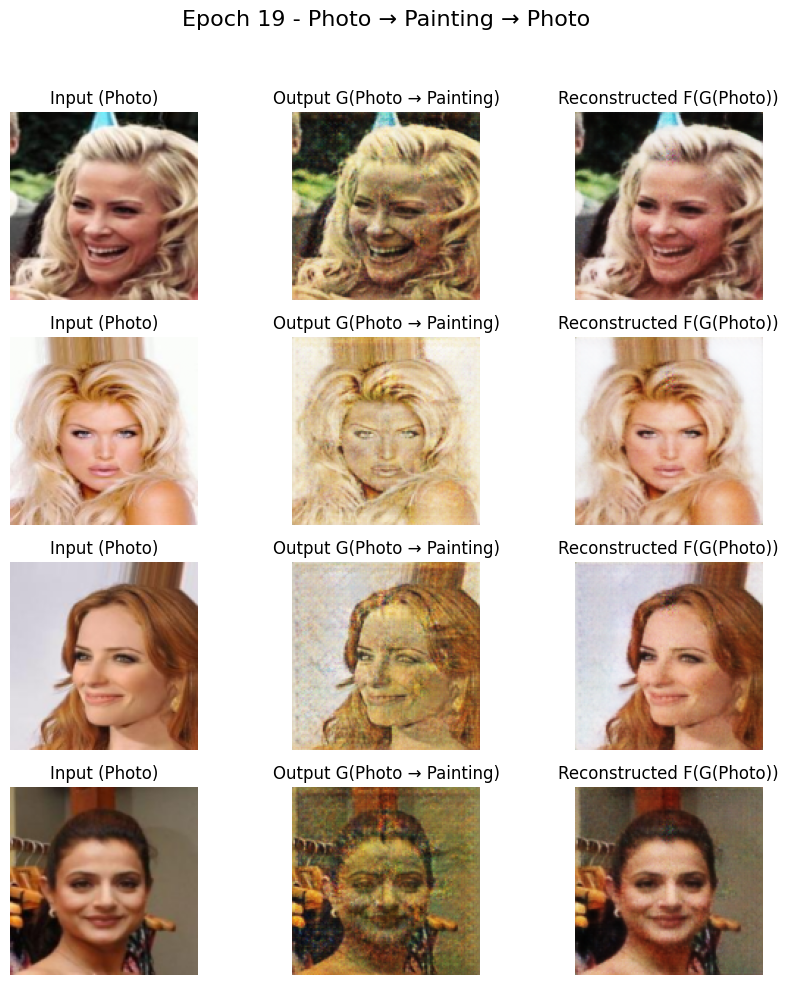

Epoch [20/20] | Step [0] | Loss_G: 3.3217 | Loss_D_A: 0.2675 | Loss_D_B: 0.0343
Epoch [20/20] | Step [100] | Loss_G: 3.6460 | Loss_D_A: 0.1235 | Loss_D_B: 0.0089
Epoch [20/20] | Step [200] | Loss_G: 3.5116 | Loss_D_A: 0.0459 | Loss_D_B: 0.0093
Epoch [20/20] | Step [300] | Loss_G: 3.1738 | Loss_D_A: 0.1529 | Loss_D_B: 0.0060
Epoch [20/20] | Step [400] | Loss_G: 2.9750 | Loss_D_A: 0.3212 | Loss_D_B: 0.0352


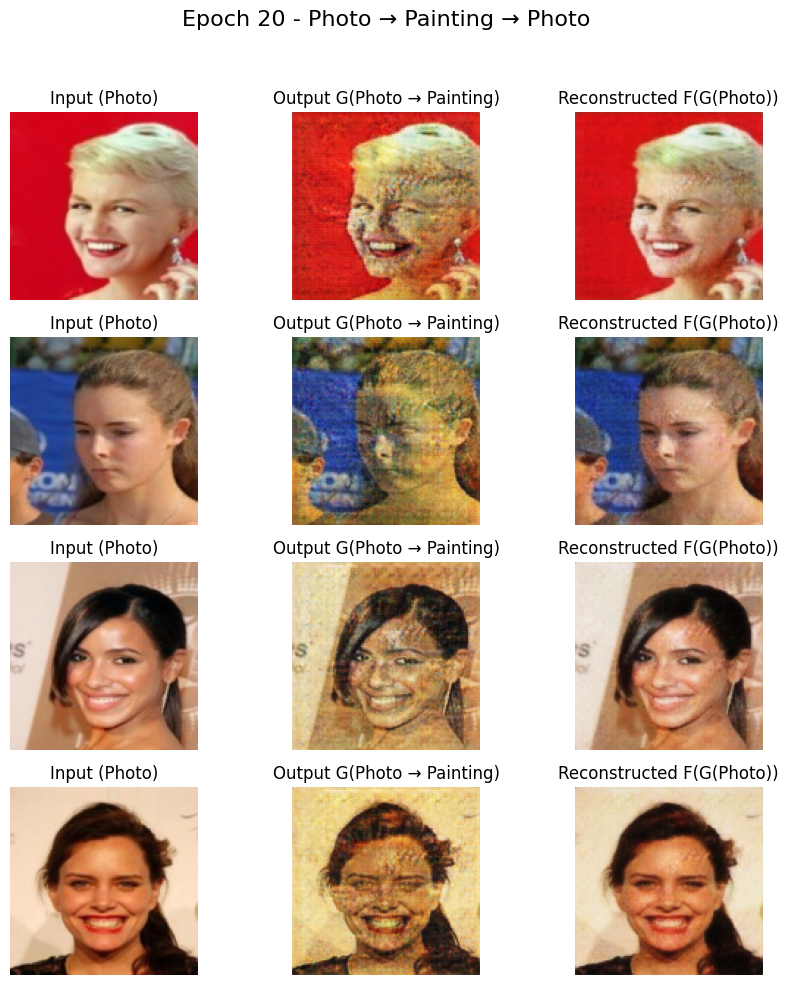

Training complete.


In [30]:
EPOCHS = 20
SAVE_DIR = "./generated"
os.makedirs(SAVE_DIR, exist_ok=True)

# Track losses
loss_G_history = []
loss_D_A_history = []
loss_D_B_history = []

# Start training
for epoch in range(1, EPOCHS + 1):
    G_AB.train()
    G_BA.train()
    
    epoch_loss_G = 0
    epoch_loss_D_A = 0
    epoch_loss_D_B = 0

    for i, batch in enumerate(train_loader):
        real_A = batch["A"].to(device)
        real_B = batch["B"].to(device)

        # Train Generators
        fake_B = G_AB(real_A)
        fake_A = G_BA(real_B)

        recon_A = G_BA(fake_B)
        recon_B = G_AB(fake_A)

        identity_A = G_BA(real_A)
        identity_B = G_AB(real_B)

        loss_identity = identity_criterion(identity_A, real_A) + identity_criterion(identity_B, real_B)
        loss_cycle = cycle_criterion(recon_A, real_A) + cycle_criterion(recon_B, real_B)
        loss_adv_G = adv_criterion(D_B(fake_B), torch.ones_like(D_B(fake_B))) + adv_criterion(D_A(fake_A), torch.ones_like(D_A(fake_A)))

        loss_G = loss_adv_G + 10 * loss_cycle + 5 * loss_identity

        opt_G.zero_grad()
        loss_G.backward()
        opt_G.step()

        # Train Discriminators
        loss_D_A = adv_criterion(D_A(real_A), torch.ones_like(D_A(real_A))) + adv_criterion(D_A(fake_A.detach()), torch.zeros_like(D_A(fake_A)))
        loss_D_B = adv_criterion(D_B(real_B), torch.ones_like(D_B(real_B))) + adv_criterion(D_B(fake_B.detach()), torch.zeros_like(D_B(fake_B)))

        opt_D_A.zero_grad()
        loss_D_A.backward()
        opt_D_A.step()

        opt_D_B.zero_grad()
        loss_D_B.backward()
        opt_D_B.step()

        epoch_loss_G += loss_G.item()
        epoch_loss_D_A += loss_D_A.item()
        epoch_loss_D_B += loss_D_B.item()

        if i % 100 == 0:
            print(f"Epoch [{epoch}/{EPOCHS}] | Step [{i}] | "
                  f"Loss_G: {loss_G.item():.4f} | Loss_D_A: {loss_D_A.item():.4f} | Loss_D_B: {loss_D_B.item():.4f}")

    # Save average epoch losses
    loss_G_history.append(epoch_loss_G / len(train_loader))
    loss_D_A_history.append(epoch_loss_D_A / len(train_loader))
    loss_D_B_history.append(epoch_loss_D_B / len(train_loader))


    # Generate and plot input → output → reconstructed triplets
    # Evaluation mode
    G_BA.eval()  # Photo → Painting
    G_AB.eval()  # Painting → Photo

    with torch.no_grad():
        # Take 4 images from domain B (real photos)
        sample = next(iter(train_loader))["B"][:4].to(device)

        fake_A = G_BA(sample)        # Translate to Monet-style (domain A)
        recon_B = G_AB(fake_A)       # Reconstruct back to photo (domain B)

        input_images = (sample + 1) / 2.0        # Real photo
        output_images = (fake_A + 1) / 2.0       # Monet-style painting
        recon_images = (recon_B + 1) / 2.0       # Reconstructed photo

        # Plot 4 rows × 3 columns: input → translated → reconstructed
        fig, axs = plt.subplots(nrows=4, ncols=3, figsize=(9, 10))

        for i in range(4):
            axs[i, 0].imshow(input_images[i].permute(1, 2, 0).cpu())
            axs[i, 0].set_title("Input (Photo)")
            axs[i, 0].axis('off')

            axs[i, 1].imshow(output_images[i].permute(1, 2, 0).cpu())
            axs[i, 1].set_title("Output G(Photo → Painting)")
            axs[i, 1].axis('off')

            axs[i, 2].imshow(recon_images[i].permute(1, 2, 0).cpu())
            axs[i, 2].set_title("Reconstructed F(G(Photo))")
            axs[i, 2].axis('off')

        plt.suptitle(f"Epoch {epoch} - Photo → Painting → Photo", fontsize=16)
        plt.tight_layout(rect=[0, 0, 1, 0.95])
        plt.savefig(f"{SAVE_DIR}/epoch_{epoch:02}_photo_to_painting_subplot.png")
        plt.show()
    
print("Training complete.")


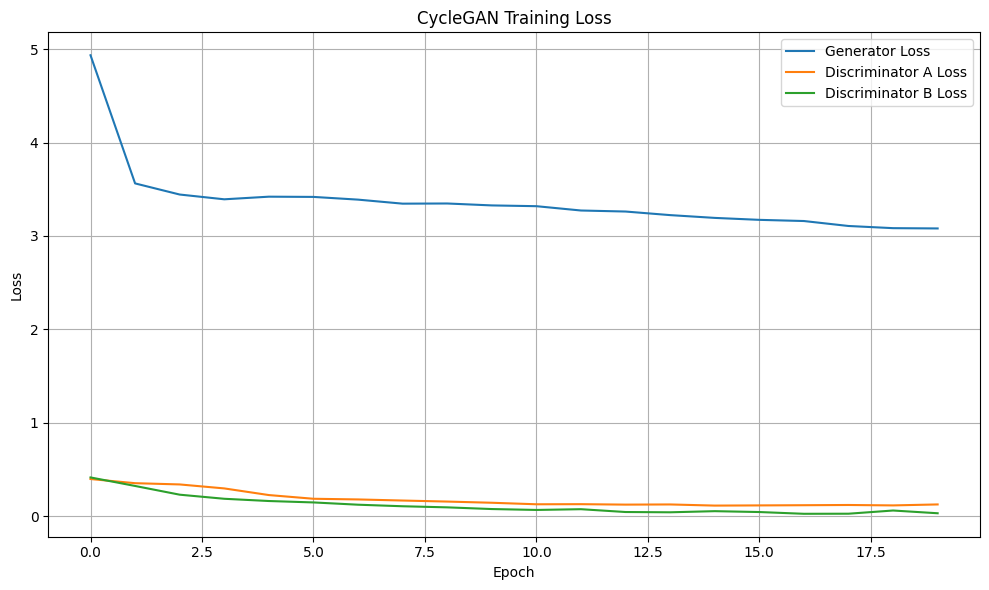

In [31]:
plt.figure(figsize=(10, 6))
plt.plot(loss_G_history, label="Generator Loss")
plt.plot(loss_D_A_history, label="Discriminator A Loss")
plt.plot(loss_D_B_history, label="Discriminator B Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("CycleGAN Training Loss")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
